# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [1]:
!nvidia-smi

Thu Feb  4 11:46:12 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
!wget https://github.com/SokolovYaroslav/hse_ml_course/raw/master/hw_6/cat_136.zip
!unzip -q cat_136.zip

--2021-02-04 11:47:43--  https://github.com/SokolovYaroslav/hse_ml_course/raw/master/hw_6/cat_136.zip
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/SokolovYaroslav/hse_ml_course/master/hw_6/cat_136.zip [following]
--2021-02-04 11:47:43--  https://raw.githubusercontent.com/SokolovYaroslav/hse_ml_course/master/hw_6/cat_136.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 61747192 (59M) [application/zip]
Saving to: ‘cat_136.zip.2’

cat_136.zip.2       100%[===================>]  58.89M   283MB/s    in 0.2s    

2021-02-04 11:47:43 (283 MB/s) - ‘cat_136.zip.2’ saved [61747192/61747192]

replace __MA

In [5]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np
import math

%matplotlib inline

In [6]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size)

def imagewide_average(x):
    return x.mean(dim=(-1, -2))

In [7]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [8]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:512 - crop_rate + x_crop, y_crop:512 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

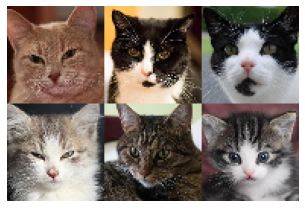

In [9]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](https://github.com/SokolovYaroslav/hse_ml_course/blob/master/hw_6/imgs/DCGAN.png?raw=1)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком локе количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [10]:
class Generator(nn.Module):
    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6, bias=False, affine=True):
        super().__init__()
        self._start_size = start_size
        self._latent_channels = latent_channels
        
        pre_block = [nn.Conv2d(latent_channels, start_channels, 1, bias=bias)]
        
        middle_block = []
        c_in = start_channels
        for _ in range(upsamplings):
            middle_block.extend([
                nn.ConvTranspose2d(c_in, c_in // 2, 4, stride=2, padding=1, bias=bias),
                nn.BatchNorm2d(c_in // 2, affine=affine),
                nn.ReLU(),
            ])
            c_in //= 2
            
        post_block = [
            nn.Conv2d(c_in, 3, 1),
            nn.Tanh(),
        ]
        
        self._nn = nn.Sequential(*(pre_block + middle_block + post_block))
        
    
    def forward(self, batch_size: int, device):
        # batch_size x 3 x (start_size * 2**upsamplings) x (start_size * 2**upsamplings)
        noise = random_noise(batch_size, self._latent_channels, self._start_size).to(device)
        return self._nn(noise)

### Задание 2 (2 балла)
Для начала реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](https://github.com/SokolovYaroslav/hse_ml_course/blob/master/hw_6/imgs/Disc_DCGAN.png?raw=1)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [11]:
class Discriminator(nn.Module):
    def __init__(self, downsamplings=6, start_channels=8, bias=True, affine=True):
        super().__init__()
        
        pre_block = [nn.Conv2d(3, start_channels, 1, bias=bias)]
        
        middle_block = []
        c_in = start_channels
        for _ in range(downsamplings):
            middle_block.extend([
                nn.Conv2d(c_in, c_in * 2, 3, stride=2, padding=1, bias=bias),
                nn.BatchNorm2d(c_in * 2, affine=affine),
                nn.ReLU(),
            ])
            c_in *= 2
            
        post_block = [
            nn.Flatten(),
            nn.Linear(2048, 1),
            nn.Sigmoid(),
        ]
        
        self._nn = nn.Sequential(*(pre_block + middle_block + post_block))
        
    def forward(self, x):
        # torch.Tensor batch_size x 1
        return self._nn(x)

In [14]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()
    epochs = 120
    visualise_every = 10
    batch_size = 8
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    generator.to(device)
    discriminator.to(device)

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            
            # Positive update
            batch = batch.to(device)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update
            batch = generator(batch_size, device=device).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size, device=device)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
        
        if (ep + 1) % visualise_every == 0:
            with torch.no_grad():
                visualise(generator(6, device=device), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")


Epoch 1 | Discriminator loss: 0.45866091610288595 | Generator loss: 4.066771143249103



Epoch 2 | Discriminator loss: 0.8286829977498754 | Generator loss: 2.3838555490748483



Epoch 3 | Discriminator loss: 0.944072759802806 | Generator loss: 2.0830550955041596



Epoch 4 | Discriminator loss: 0.8829461727754114 | Generator loss: 2.1233620614924047



Epoch 5 | Discriminator loss: 0.8367445668876634 | Generator loss: 2.1956536193256793



Epoch 6 | Discriminator loss: 0.7676313789387853 | Generator loss: 2.3734157738848505



Epoch 7 | Discriminator loss: 0.7185880067174016 | Generator loss: 2.4484724755983174



Epoch 8 | Discriminator loss: 0.670335301961634 | Generator loss: 2.560679966526002



Epoch 9 | Discriminator loss: 0.6081163723770853 | Generator loss: 2.6945054834673865


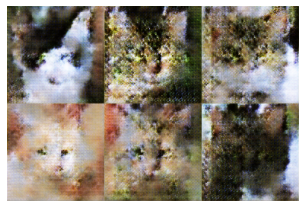

Epoch 10 | Discriminator loss: 0.5671674676165556 | Generator loss: 2.944807141093734



Epoch 11 | Discriminator loss: 0.4988907217102339 | Generator loss: 3.202028188461102



Epoch 12 | Discriminator loss: 0.5068997930310903 | Generator loss: 3.1462412870818786



Epoch 13 | Discriminator loss: 0.45831041876985895 | Generator loss: 3.2344411025691477



Epoch 14 | Discriminator loss: 0.4561480403908887 | Generator loss: 3.3088831451276075



Epoch 15 | Discriminator loss: 0.47547851516597656 | Generator loss: 3.38053247809225



Epoch 16 | Discriminator loss: 0.407846846030349 | Generator loss: 3.543144790004499



Epoch 17 | Discriminator loss: 0.42259590921182183 | Generator loss: 3.4156319913194046



Epoch 18 | Discriminator loss: 0.39752465599678927 | Generator loss: 3.6193670303740118



Epoch 19 | Discriminator loss: 0.39337378183211835 | Generator loss: 3.5804724681729114


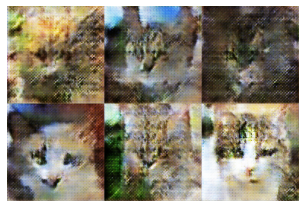

Epoch 20 | Discriminator loss: 0.3951338051390069 | Generator loss: 3.538146395398223



Epoch 21 | Discriminator loss: 0.35835719166549684 | Generator loss: 3.865313880562042



Epoch 22 | Discriminator loss: 0.3482572974590196 | Generator loss: 3.804851446508991



Epoch 23 | Discriminator loss: 0.3610053138438376 | Generator loss: 3.891213259804323



Epoch 24 | Discriminator loss: 0.36382661105550446 | Generator loss: 3.728336189104163



Epoch 25 | Discriminator loss: 0.33299879737222576 | Generator loss: 3.779117887990075



Epoch 26 | Discriminator loss: 0.3559958501826948 | Generator loss: 3.912199559233944



Epoch 27 | Discriminator loss: 0.3173618760073459 | Generator loss: 4.132489704845114



Epoch 28 | Discriminator loss: 0.30877328398970993 | Generator loss: 4.198679185894705



Epoch 29 | Discriminator loss: 0.29592069052925796 | Generator loss: 4.023036934898137


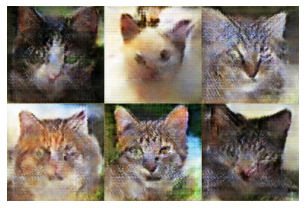

Epoch 30 | Discriminator loss: 0.31000270668483265 | Generator loss: 4.148379408424685



Epoch 31 | Discriminator loss: 0.29565788701087775 | Generator loss: 4.420893508640135



Epoch 32 | Discriminator loss: 0.28782096486401265 | Generator loss: 4.0934311601778735



Epoch 33 | Discriminator loss: 0.3118978200423891 | Generator loss: 4.32705228442546



Epoch 34 | Discriminator loss: 0.27052018607031164 | Generator loss: 4.366174408552809



Epoch 35 | Discriminator loss: 0.2932681143305536 | Generator loss: 4.3906470917581775



Epoch 36 | Discriminator loss: 0.2646019536137568 | Generator loss: 4.35611614834818



Epoch 37 | Discriminator loss: 0.26729382490929937 | Generator loss: 4.496107801239683



Epoch 38 | Discriminator loss: 0.2567056081740719 | Generator loss: 4.5205948908136495



Epoch 39 | Discriminator loss: 0.24556177134285948 | Generator loss: 4.687952142509615


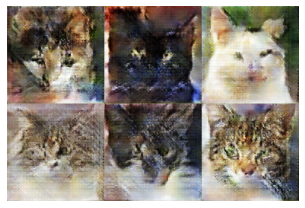

Epoch 40 | Discriminator loss: 0.24644586079894026 | Generator loss: 4.532238539238894



Epoch 41 | Discriminator loss: 0.23632826845188212 | Generator loss: 4.788310302155359



Epoch 42 | Discriminator loss: 0.24306261360937848 | Generator loss: 4.672994509802102



Epoch 43 | Discriminator loss: 0.21604215723366324 | Generator loss: 4.827011086740849



Epoch 44 | Discriminator loss: 0.21414289838329756 | Generator loss: 5.0495844867473805



Epoch 45 | Discriminator loss: 0.21836889383229058 | Generator loss: 4.817693289577591



Epoch 46 | Discriminator loss: 0.22256692249749752 | Generator loss: 4.961896981465521



Epoch 47 | Discriminator loss: 0.21984760162666428 | Generator loss: 4.95658913624953



Epoch 48 | Discriminator loss: 0.212513588592747 | Generator loss: 4.80220260614564



Epoch 49 | Discriminator loss: 0.21785993586228972 | Generator loss: 4.951065789283432


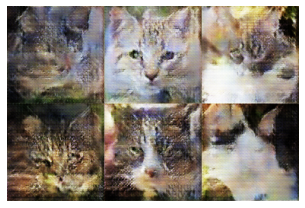

Epoch 50 | Discriminator loss: 0.22631085157958838 | Generator loss: 4.943834652441629



Epoch 51 | Discriminator loss: 0.19609247201043004 | Generator loss: 5.061737400219307



Epoch 52 | Discriminator loss: 0.21727922342605221 | Generator loss: 4.984723243376483



Epoch 53 | Discriminator loss: 0.182239083826577 | Generator loss: 5.119101296300474



Epoch 54 | Discriminator loss: 0.20306546108502174 | Generator loss: 5.068760310085664



Epoch 55 | Discriminator loss: 0.19823675323794315 | Generator loss: 5.0608001871508845



Epoch 56 | Discriminator loss: 0.19660636403196233 | Generator loss: 5.077566519934939



Epoch 57 | Discriminator loss: 0.21878557034562862 | Generator loss: 5.077329138143463



Epoch 58 | Discriminator loss: 0.1917630657923607 | Generator loss: 5.360908175940099



Epoch 59 | Discriminator loss: 0.15441714940194784 | Generator loss: 5.364356001989441


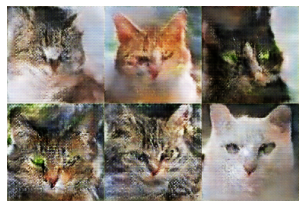

Epoch 60 | Discriminator loss: 0.17945075355795456 | Generator loss: 5.4105173660361245



Epoch 61 | Discriminator loss: 0.1676578431340164 | Generator loss: 5.214575510957967



Epoch 62 | Discriminator loss: 0.18095570200913522 | Generator loss: 5.351475045547723



Epoch 63 | Discriminator loss: 0.18463778475532547 | Generator loss: 5.453921148032876



Epoch 64 | Discriminator loss: 0.17947863124116215 | Generator loss: 5.288507522078034



Epoch 65 | Discriminator loss: 0.1884063905636853 | Generator loss: 5.628799177474857



Epoch 66 | Discriminator loss: 0.16522861123025404 | Generator loss: 5.46764000639412



Epoch 67 | Discriminator loss: 0.166771293301937 | Generator loss: 5.493424350245399



Epoch 68 | Discriminator loss: 0.16070745932856823 | Generator loss: 5.527543718215101



Epoch 69 | Discriminator loss: 0.1547486354563833 | Generator loss: 5.4527121998415975


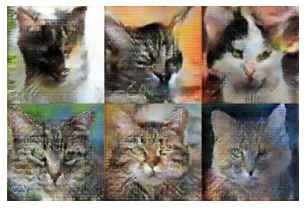

Epoch 70 | Discriminator loss: 0.1671540343253897 | Generator loss: 5.6182350190529915



Epoch 71 | Discriminator loss: 0.1543027028443373 | Generator loss: 5.877901459147471



Epoch 72 | Discriminator loss: 0.16107556043222793 | Generator loss: 5.606665554670443



Epoch 73 | Discriminator loss: 0.17305002548080026 | Generator loss: 5.561612498315966



Epoch 74 | Discriminator loss: 0.14468319024178233 | Generator loss: 5.569760078043672



Epoch 75 | Discriminator loss: 0.1424720021648467 | Generator loss: 5.71838394899546



Epoch 76 | Discriminator loss: 0.14246351272849167 | Generator loss: 5.85537197704641



Epoch 77 | Discriminator loss: 0.13961660513887578 | Generator loss: 6.032077948869385



Epoch 78 | Discriminator loss: 0.14232449678184503 | Generator loss: 5.862597748637199



Epoch 79 | Discriminator loss: 0.1538657667015807 | Generator loss: 5.7715580520792775


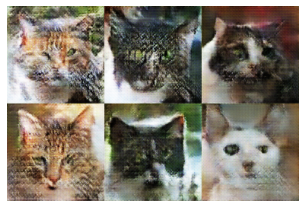

Epoch 80 | Discriminator loss: 0.12180058067682357 | Generator loss: 5.886150808530565



Epoch 81 | Discriminator loss: 0.1525520183814419 | Generator loss: 6.030411605648002



Epoch 82 | Discriminator loss: 0.14620237556278712 | Generator loss: 5.963881398487535



Epoch 83 | Discriminator loss: 0.13607953017157723 | Generator loss: 5.827858651832024



Epoch 84 | Discriminator loss: 0.13977846568651692 | Generator loss: 6.137949063540986



Epoch 85 | Discriminator loss: 0.12949038745739577 | Generator loss: 6.132938990681808



Epoch 86 | Discriminator loss: 0.11894421321739794 | Generator loss: 6.106134255110107



Epoch 87 | Discriminator loss: 0.11084710137530629 | Generator loss: 6.300401007536776



Epoch 88 | Discriminator loss: 0.13466613334750907 | Generator loss: 6.145964819868529



Epoch 89 | Discriminator loss: 0.1330280186603618 | Generator loss: 6.128497629686727


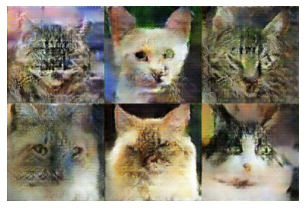

Epoch 90 | Discriminator loss: 0.11993287213493287 | Generator loss: 6.223028171691835



Epoch 91 | Discriminator loss: 0.11196060217176666 | Generator loss: 6.009910499457247



Epoch 92 | Discriminator loss: 0.12307113961697154 | Generator loss: 6.37672136011331



Epoch 93 | Discriminator loss: 0.10678647544061924 | Generator loss: 6.455307078842791



Epoch 94 | Discriminator loss: 0.1225004016700338 | Generator loss: 6.36902165172263



Epoch 95 | Discriminator loss: 0.12367117006558058 | Generator loss: 6.504619925011019



Epoch 96 | Discriminator loss: 0.12380409648130722 | Generator loss: 6.414744837221152



Epoch 97 | Discriminator loss: 0.12224882410129823 | Generator loss: 6.13906770352251



Epoch 98 | Discriminator loss: 0.11612453941614602 | Generator loss: 6.558866771481792



Epoch 99 | Discriminator loss: 0.12572081436765326 | Generator loss: 6.4506834873131345


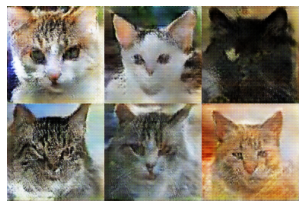

Epoch 100 | Discriminator loss: 0.10360846372925644 | Generator loss: 6.3263293251117565



Epoch 101 | Discriminator loss: 0.10409408226288745 | Generator loss: 6.4817306574272076



Epoch 102 | Discriminator loss: 0.12172432287554137 | Generator loss: 6.4436572367175025



Epoch 103 | Discriminator loss: 0.10987972919540527 | Generator loss: 6.409760340770579



Epoch 104 | Discriminator loss: 0.13091791913868125 | Generator loss: 6.409338550815671



Epoch 105 | Discriminator loss: 0.11188119037159083 | Generator loss: 6.550699034092589



Epoch 106 | Discriminator loss: 0.1061071567370276 | Generator loss: 6.618006783427659



Epoch 107 | Discriminator loss: 0.11872747873452341 | Generator loss: 6.652588106090238



Epoch 108 | Discriminator loss: 0.11354877848781439 | Generator loss: 6.575369130658067



Epoch 109 | Discriminator loss: 0.08489331689242466 | Generator loss: 6.719650025323311


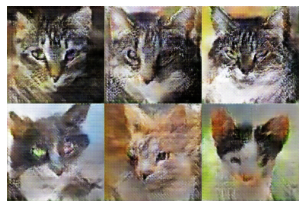

Epoch 110 | Discriminator loss: 0.11706839366971934 | Generator loss: 6.711226717840811



Epoch 111 | Discriminator loss: 0.09818371400584447 | Generator loss: 6.643558974221627



Epoch 112 | Discriminator loss: 0.10978498512849973 | Generator loss: 6.911309170056574



Epoch 113 | Discriminator loss: 0.13272811750999933 | Generator loss: 6.412742368552996



Epoch 114 | Discriminator loss: 0.09739267212876257 | Generator loss: 6.588271205099473



Epoch 115 | Discriminator loss: 0.10449947771539587 | Generator loss: 6.75645768336998



Epoch 116 | Discriminator loss: 0.10512886922633952 | Generator loss: 6.935977418230187



Epoch 117 | Discriminator loss: 0.08846419852676177 | Generator loss: 6.791221636237565



Epoch 118 | Discriminator loss: 0.08239880903501935 | Generator loss: 6.787904445243918



Epoch 119 | Discriminator loss: 0.09519841565392627 | Generator loss: 6.995533634416805


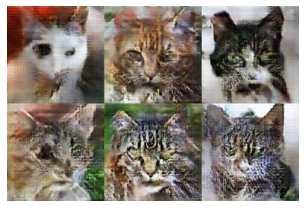

Epoch 120 | Discriminator loss: 0.10702555051607578 | Generator loss: 6.85018760706327


In [15]:
train_gan()

Котики генерятся, попробовал разные способы убрать bias: через bias и affine. Кажется лучше получалось с affine, то это как-то слабо объясняется, поэтому сделал как привычно, через bias.

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличии от GAN, в котором генератор пытается себя обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](https://github.com/SokolovYaroslav/hse_ml_course/blob/master/hw_6/imgs/VAE.png?raw=1)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](https://github.com/SokolovYaroslav/hse_ml_course/blob/master/hw_6/imgs/VAE_highlevel.png?raw=1)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [16]:
class Encoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, down_channels=8):
        super().__init__()
        
        self._latent_size = latent_size
        num_blocks = int(math.log2(img_size))
        
        modules = []
        
        modules.append(nn.Conv2d(3, down_channels, 1))
        
        for _ in range(num_blocks):
            modules.append(nn.Conv2d(down_channels, down_channels * 2, 3, stride=2, padding=1))
            modules.append(nn.BatchNorm2d(down_channels * 2))
            modules.append(nn.ReLU())
            down_channels *= 2
            
        modules.append(nn.Conv2d(down_channels, 2 * latent_size, 1))
        modules.append(nn.Flatten())
        
        self._nn = nn.Sequential(*modules)
        
    def forward(self, x):
        mu, sigma_logit = torch.split(self._nn(x), self._latent_size, dim=-1)
        return mu, torch.exp(sigma_logit)

In [17]:
class Decoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, up_channels=16):
        super().__init__()
        
        num_blocks = int(math.log2(img_size))
        num_c = up_channels * 2 ** num_blocks
        
        modules = []
        
        modules.append(nn.Conv2d(latent_size, num_c, 1))
        
        for _ in range(num_blocks):
            modules.append(nn.ConvTranspose2d(num_c, num_c // 2, 4, stride=2, padding=1))
            modules.append(nn.BatchNorm2d(num_c // 2))
            modules.append(nn.ReLU())
            num_c //= 2
        assert num_c == up_channels
        
        modules.append(nn.Conv2d(num_c, 3, 1))
        modules.append(nn.Tanh())
        
        self._nn = nn.Sequential(*modules)
        
    def forward(self, z):
        return self._nn(z[:, :, None, None])

In [18]:
class VAE(nn.Module):
    def __init__(self, img_size=128, latent_size=512, down_channels=8, up_channels=16):
        super().__init__()
        self._latent_size = latent_size
        
        self.encoder = Encoder(img_size, latent_size, down_channels)
        self.decoder = Decoder(img_size, latent_size, up_channels)
        
    def forward(self, x):
        mu, sigma_2 = self.encoder(x)
        z = mu + torch.randn(mu.size()).to(x.device) * sigma_2
        x_pred = self.decoder(z)
        kld = 0.5 * (sigma_2 + torch.square(mu) - torch.log(sigma_2) - 1)
        return x_pred, kld
    
    def encode(self, x):
        mu, sigma_2 = self.encoder(x)
        return mu + torch.randn(mu.size()).to(x.device) * sigma_2
    
    def decode(self, z):
        return self.decoder(z)

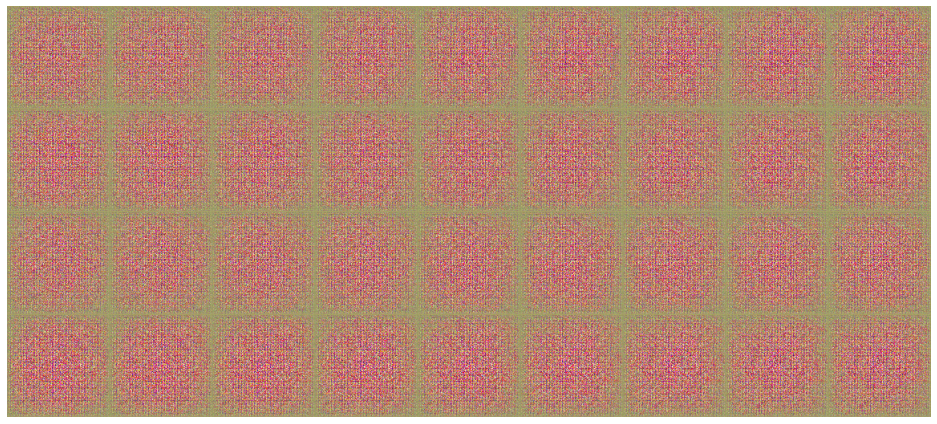

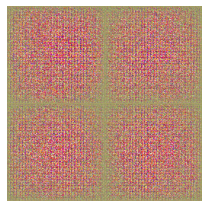


Epoch 1 | Reconstruction loss: 9556.580025809151 | KLD loss: 205.79959407356216



Epoch 2 | Reconstruction loss: 6896.006001916731 | KLD loss: 289.59174529365873



Epoch 3 | Reconstruction loss: 6406.847169485151 | KLD loss: 340.80801268393947



Epoch 4 | Reconstruction loss: 6006.509173470255 | KLD loss: 373.66279379329325



Epoch 5 | Reconstruction loss: 5723.995764311796 | KLD loss: 396.00459175820674



Epoch 6 | Reconstruction loss: 5578.296326062694 | KLD loss: 409.3780286326912



Epoch 7 | Reconstruction loss: 5408.656960054955 | KLD loss: 424.9338504957116



Epoch 8 | Reconstruction loss: 5238.940839494978 | KLD loss: 442.7779008379634



Epoch 9 | Reconstruction loss: 5048.921773401106 | KLD loss: 455.71072956345836



Epoch 10 | Reconstruction loss: 4931.797012234327 | KLD loss: 462.8499160671827


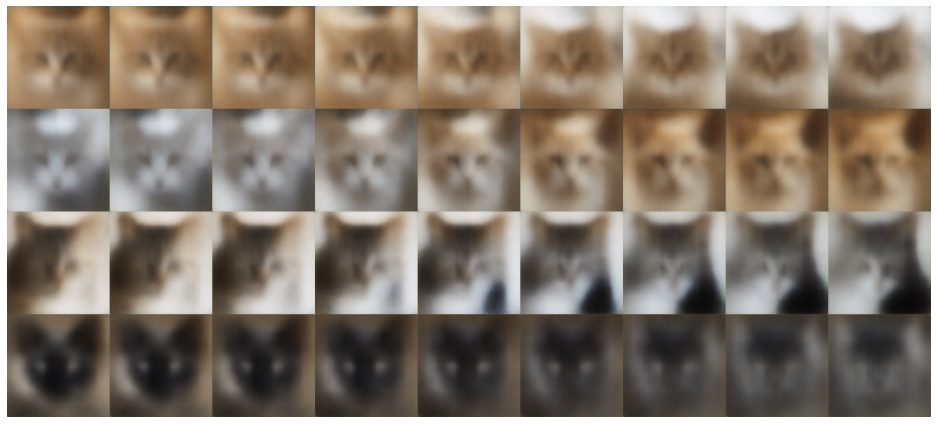

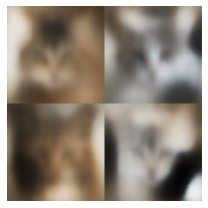


Epoch 11 | Reconstruction loss: 4855.13253007024 | KLD loss: 468.1699980267827



Epoch 12 | Reconstruction loss: 4762.206979692352 | KLD loss: 466.6134366337557



Epoch 13 | Reconstruction loss: 4672.722224454702 | KLD loss: 471.01043497405436



Epoch 14 | Reconstruction loss: 4596.540775275378 | KLD loss: 476.75638187005654



Epoch 15 | Reconstruction loss: 4492.5282797487625 | KLD loss: 480.6007733078477



Epoch 16 | Reconstruction loss: 4446.387069038723 | KLD loss: 483.61831428101345



Epoch 17 | Reconstruction loss: 4367.058885278168 | KLD loss: 488.86652687025367



Epoch 18 | Reconstruction loss: 4316.329113693711 | KLD loss: 492.26564371807973



Epoch 19 | Reconstruction loss: 4261.544742939635 | KLD loss: 495.4680039305124



Epoch 20 | Reconstruction loss: 4218.039967412534 | KLD loss: 499.390826254898


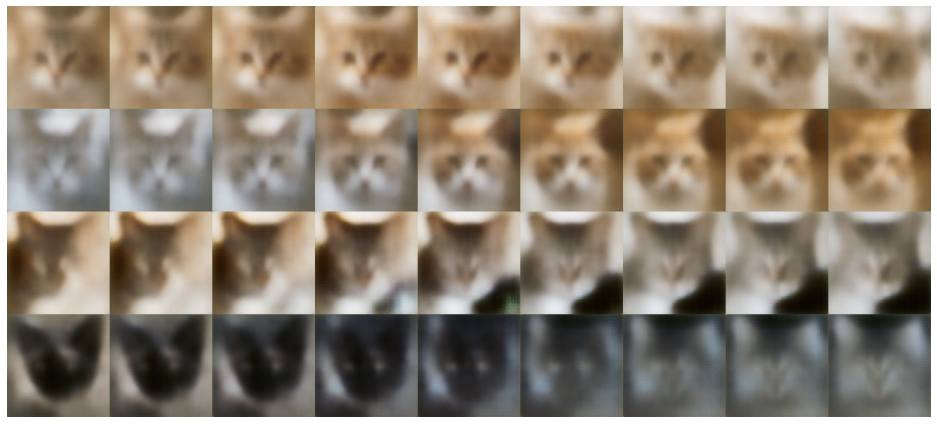

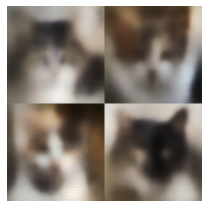


Epoch 21 | Reconstruction loss: 4178.628493409719 | KLD loss: 502.5954233015546



Epoch 22 | Reconstruction loss: 4150.428359511476 | KLD loss: 501.45547163116265



Epoch 23 | Reconstruction loss: 4082.810569621021 | KLD loss: 505.88286130917



Epoch 24 | Reconstruction loss: 4072.5545658087876 | KLD loss: 505.3947444939465



Epoch 25 | Reconstruction loss: 4014.243242536272 | KLD loss: 510.0071185094229



Epoch 26 | Reconstruction loss: 4000.8780183969816 | KLD loss: 512.499136835892



Epoch 27 | Reconstruction loss: 3936.282392608453 | KLD loss: 515.6036080307101



Epoch 28 | Reconstruction loss: 3920.204536390601 | KLD loss: 518.8032765832747



Epoch 29 | Reconstruction loss: 3864.0959343762133 | KLD loss: 521.7621144833772



Epoch 30 | Reconstruction loss: 3835.0258880046586 | KLD loss: 523.3031146126505


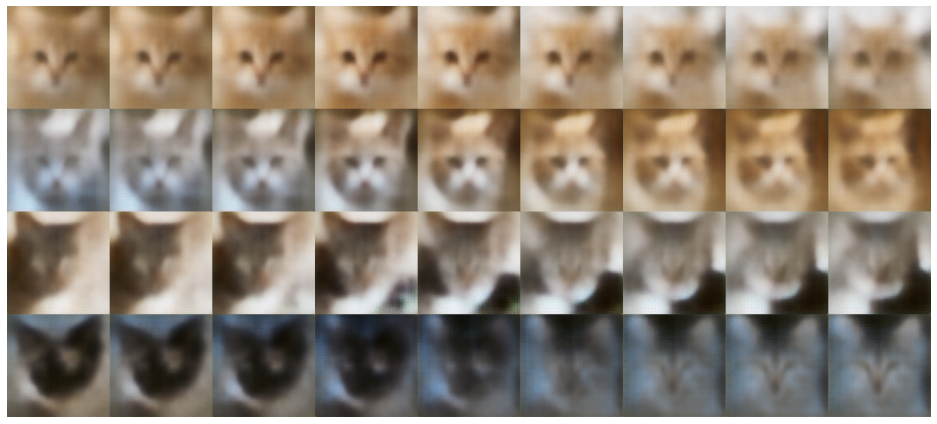

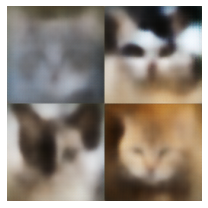


Epoch 31 | Reconstruction loss: 3810.7173427795033 | KLD loss: 523.8859672783325



Epoch 32 | Reconstruction loss: 3795.052719969187 | KLD loss: 526.5244790308224



Epoch 33 | Reconstruction loss: 3739.9691901355054 | KLD loss: 526.2947624633031



Epoch 34 | Reconstruction loss: 3729.020959321016 | KLD loss: 529.9777687499242



Epoch 35 | Reconstruction loss: 3710.654692655765 | KLD loss: 533.0251556775585



Epoch 36 | Reconstruction loss: 3682.5409879506747 | KLD loss: 529.4732965031026



Epoch 37 | Reconstruction loss: 3648.2515304281105 | KLD loss: 532.754674402083



Epoch 38 | Reconstruction loss: 3633.275903926873 | KLD loss: 537.4773691307684



Epoch 39 | Reconstruction loss: 3614.06882566843 | KLD loss: 535.2766865795444



Epoch 40 | Reconstruction loss: 3591.5807741532412 | KLD loss: 538.7067085408275


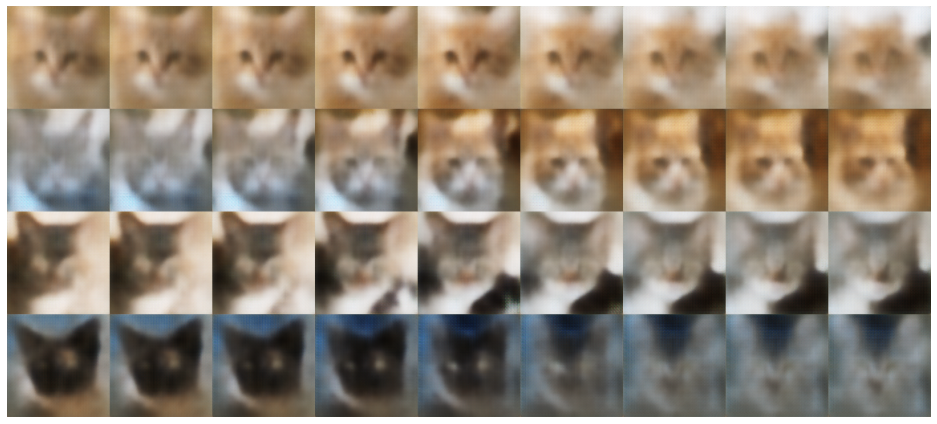

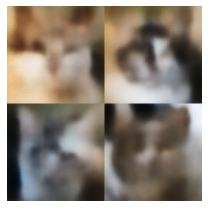


Epoch 41 | Reconstruction loss: 3541.6187073133005 | KLD loss: 539.9277620967131



Epoch 42 | Reconstruction loss: 3547.4662475585938 | KLD loss: 540.8540031480493



Epoch 43 | Reconstruction loss: 3534.3693919685315 | KLD loss: 544.6769164659962



Epoch 44 | Reconstruction loss: 3494.1902515103357 | KLD loss: 541.609250797248



Epoch 45 | Reconstruction loss: 3462.100673888781 | KLD loss: 543.3510975334215



Epoch 46 | Reconstruction loss: 3458.7575820069874 | KLD loss: 545.025106299738



Epoch 47 | Reconstruction loss: 3439.5461387871214 | KLD loss: 548.2177607850258



Epoch 48 | Reconstruction loss: 3418.567714904406 | KLD loss: 547.8465980861498



Epoch 49 | Reconstruction loss: 3394.228119465135 | KLD loss: 546.4622415104268



Epoch 50 | Reconstruction loss: 3389.371601744468 | KLD loss: 548.5035345421074


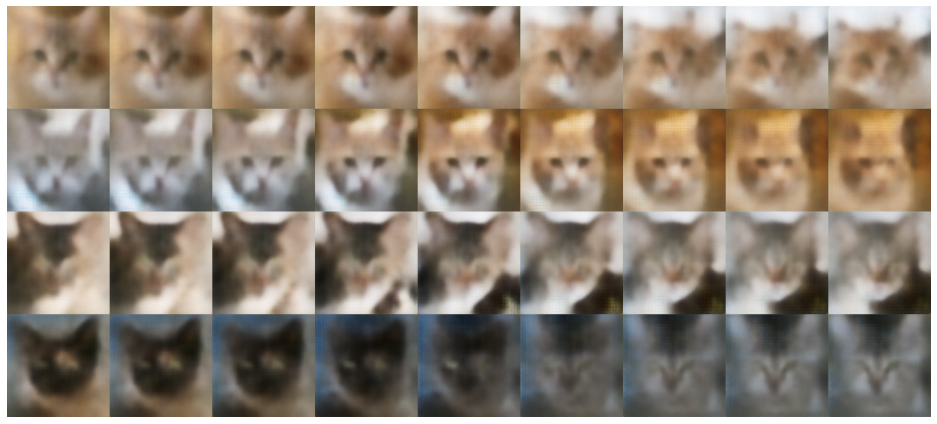

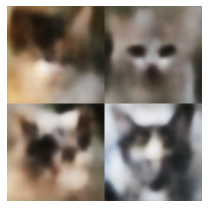


Epoch 51 | Reconstruction loss: 3363.408690268949 | KLD loss: 546.2355259012731



Epoch 52 | Reconstruction loss: 3344.1803368988985 | KLD loss: 549.32510039525



Epoch 53 | Reconstruction loss: 3323.6787659070505 | KLD loss: 550.8278617148073



Epoch 54 | Reconstruction loss: 3304.409148222171 | KLD loss: 550.3577606959373



Epoch 55 | Reconstruction loss: 3305.986830812063 | KLD loss: 550.6810715953756



Epoch 56 | Reconstruction loss: 3291.499888354947 | KLD loss: 553.4058655448582



Epoch 57 | Reconstruction loss: 3260.4827642026153 | KLD loss: 551.9162549320955



Epoch 58 | Reconstruction loss: 3264.05673805379 | KLD loss: 551.6792572211034



Epoch 59 | Reconstruction loss: 3232.602685395235 | KLD loss: 552.6231287606755



Epoch 60 | Reconstruction loss: 3211.745240774214 | KLD loss: 551.0344869483332


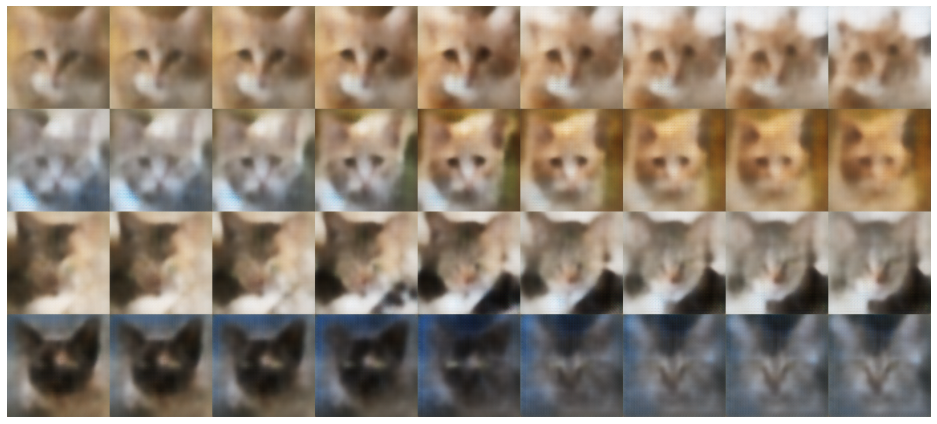

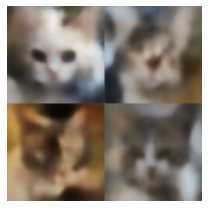


Epoch 61 | Reconstruction loss: 3198.7016108732046 | KLD loss: 553.4664155948236



Epoch 62 | Reconstruction loss: 3190.368091275233 | KLD loss: 555.8978939174865



Epoch 63 | Reconstruction loss: 3173.068199773753 | KLD loss: 551.7882695642318



Epoch 64 | Reconstruction loss: 3167.9399853818904 | KLD loss: 555.3460874379792



Epoch 65 | Reconstruction loss: 3154.0715445761357 | KLD loss: 557.6421183710513



Epoch 66 | Reconstruction loss: 3148.0742540063325 | KLD loss: 555.5064959792617



Epoch 67 | Reconstruction loss: 3112.6673898637664 | KLD loss: 557.9236264436141



Epoch 68 | Reconstruction loss: 3110.460042064975 | KLD loss: 557.830042300017



Epoch 69 | Reconstruction loss: 3098.761482380932 | KLD loss: 555.3746387647545



Epoch 70 | Reconstruction loss: 3087.5330410596007 | KLD loss: 552.9236444982682


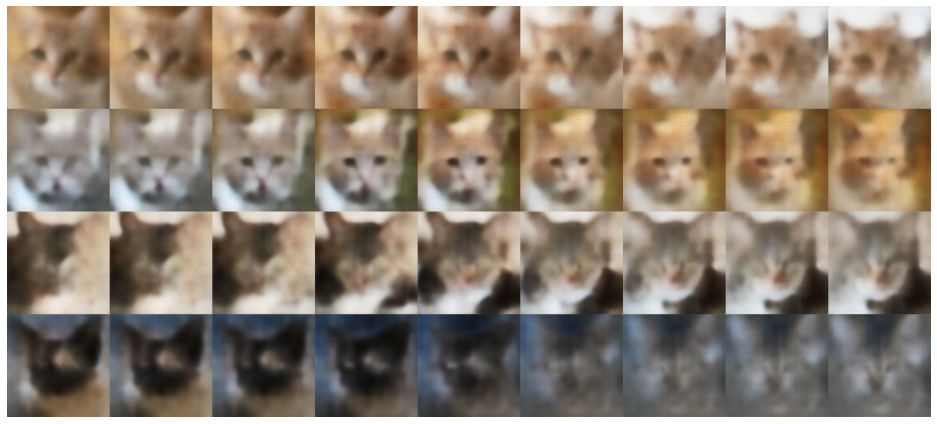

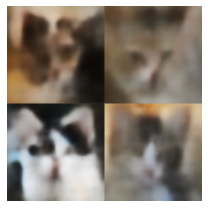


Epoch 71 | Reconstruction loss: 3082.6672539562915 | KLD loss: 559.9033785991787



Epoch 72 | Reconstruction loss: 3051.0813632751842 | KLD loss: 558.9377716254003



Epoch 73 | Reconstruction loss: 3046.4497193520115 | KLD loss: 557.1765295940896



Epoch 74 | Reconstruction loss: 3043.839916537267 | KLD loss: 553.9932219700784



Epoch 75 | Reconstruction loss: 3024.7009882008806 | KLD loss: 557.0214690214359



Epoch 76 | Reconstruction loss: 3029.116150091894 | KLD loss: 556.9690908112141



Epoch 77 | Reconstruction loss: 3002.347440541901 | KLD loss: 555.3381765614386



Epoch 78 | Reconstruction loss: 2998.615469796317 | KLD loss: 555.5707390826682



Epoch 79 | Reconstruction loss: 2982.725919924908 | KLD loss: 557.2805307992497



Epoch 80 | Reconstruction loss: 2955.098291243085 | KLD loss: 555.5495224946774


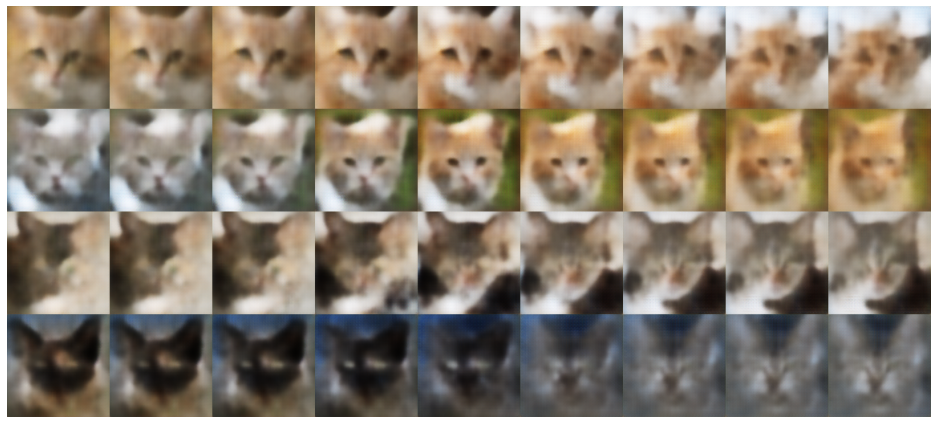

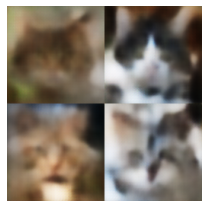


Epoch 81 | Reconstruction loss: 2968.6312003757644 | KLD loss: 557.0198921535326



Epoch 82 | Reconstruction loss: 2949.2064887574 | KLD loss: 559.2174439992964



Epoch 83 | Reconstruction loss: 2931.7581722662317 | KLD loss: 557.7133253583256



Epoch 84 | Reconstruction loss: 2932.464228659683 | KLD loss: 556.4467365904625



Epoch 85 | Reconstruction loss: 2919.131158864276 | KLD loss: 552.6603839945349



Epoch 86 | Reconstruction loss: 2919.00804052886 | KLD loss: 554.4331209644768



Epoch 87 | Reconstruction loss: 2881.5645414553815 | KLD loss: 554.4875634234885



Epoch 88 | Reconstruction loss: 2886.466446586277 | KLD loss: 555.5410051997404



Epoch 89 | Reconstruction loss: 2873.4886618667506 | KLD loss: 553.7325832769737



Epoch 90 | Reconstruction loss: 2865.675449916295 | KLD loss: 552.6656083764497


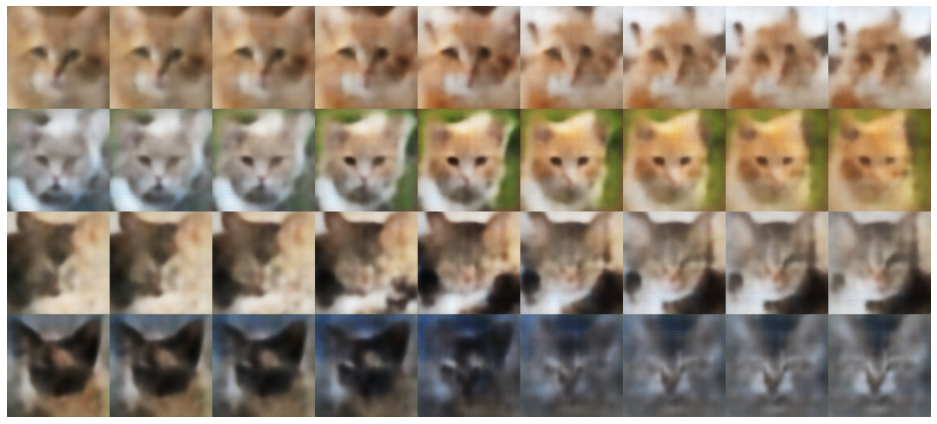

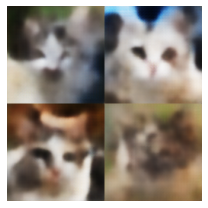


Epoch 91 | Reconstruction loss: 2857.393948383213 | KLD loss: 555.3791720467325



Epoch 92 | Reconstruction loss: 2852.377138694621 | KLD loss: 555.398748930937



Epoch 93 | Reconstruction loss: 2825.680052194536 | KLD loss: 554.3313772071223



Epoch 94 | Reconstruction loss: 2835.4083631053472 | KLD loss: 554.8037372849743



Epoch 95 | Reconstruction loss: 2810.8342823478747 | KLD loss: 553.3558307434461



Epoch 96 | Reconstruction loss: 2806.4861505164863 | KLD loss: 555.03715548308



Epoch 97 | Reconstruction loss: 2808.3476744468167 | KLD loss: 554.2894685164741



Epoch 98 | Reconstruction loss: 2795.4912935813763 | KLD loss: 553.57072207054



Epoch 99 | Reconstruction loss: 2793.088222716906 | KLD loss: 556.3846524635458



Epoch 100 | Reconstruction loss: 2778.247355585513 | KLD loss: 552.3907147520077


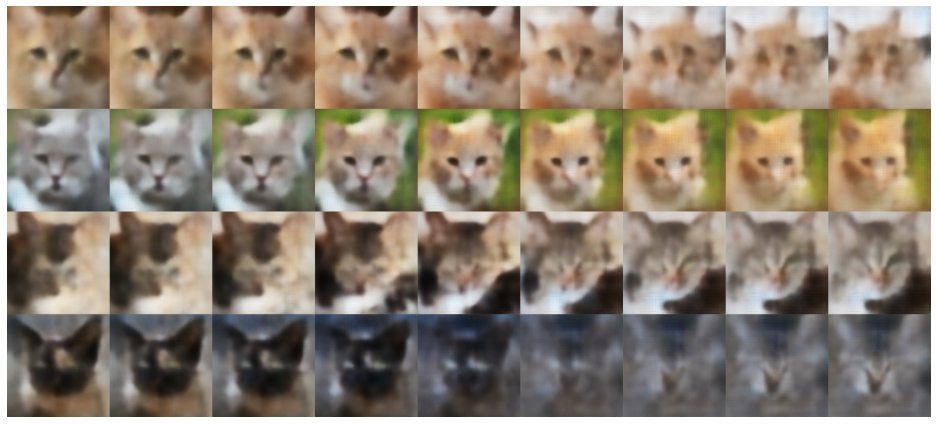

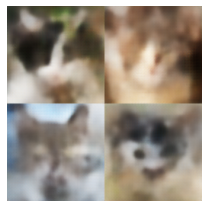


Epoch 101 | Reconstruction loss: 2770.477589103746 | KLD loss: 555.167042133971



Epoch 102 | Reconstruction loss: 2761.300746562318 | KLD loss: 554.3700822154927



Epoch 103 | Reconstruction loss: 2744.6681838894483 | KLD loss: 551.0510982726672



Epoch 104 | Reconstruction loss: 2748.638332580187 | KLD loss: 553.8248882886046



Epoch 105 | Reconstruction loss: 2745.6689817061338 | KLD loss: 553.8959373805834



Epoch 106 | Reconstruction loss: 2726.701396681507 | KLD loss: 553.0542075115701



Epoch 107 | Reconstruction loss: 2714.2488084876018 | KLD loss: 551.2235765160981



Epoch 108 | Reconstruction loss: 2715.6946077524503 | KLD loss: 550.3213071645417



Epoch 109 | Reconstruction loss: 2705.031255686505 | KLD loss: 553.4267917419812



Epoch 110 | Reconstruction loss: 2691.3047750721807 | KLD loss: 548.4682696324697


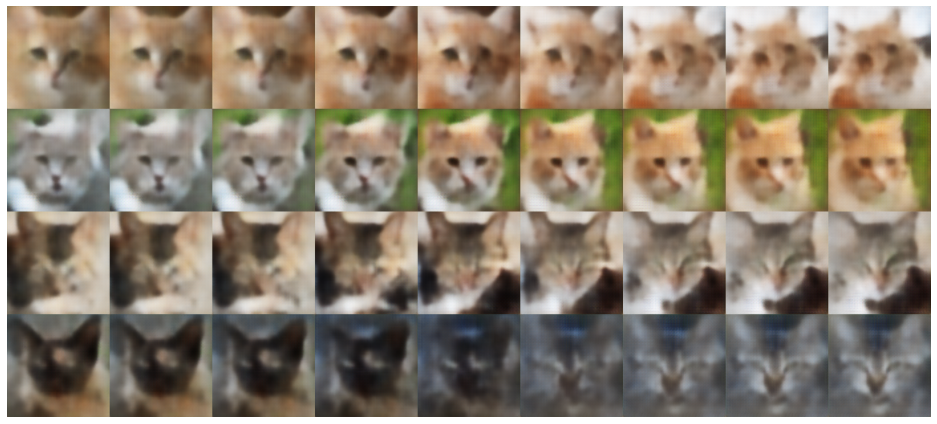

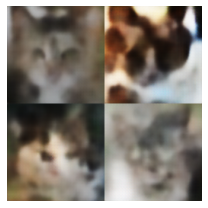


Epoch 111 | Reconstruction loss: 2689.1552353379147 | KLD loss: 551.9955781735248



Epoch 112 | Reconstruction loss: 2676.080930721686 | KLD loss: 549.0155232115562



Epoch 113 | Reconstruction loss: 2677.861898102375 | KLD loss: 547.7416273792338



Epoch 114 | Reconstruction loss: 2665.7278269892154 | KLD loss: 545.4117349186299



Epoch 115 | Reconstruction loss: 2661.944594104838 | KLD loss: 548.3109164504531



Epoch 116 | Reconstruction loss: 2651.836409479935 | KLD loss: 549.0188379228485



Epoch 117 | Reconstruction loss: 2648.6367200768514 | KLD loss: 547.3122784632334



Epoch 118 | Reconstruction loss: 2652.356495353746 | KLD loss: 549.4272873683005



Epoch 119 | Reconstruction loss: 2636.660591267651 | KLD loss: 548.79632980631



Epoch 120 | Reconstruction loss: 2644.012832736377 | KLD loss: 546.4826841650543


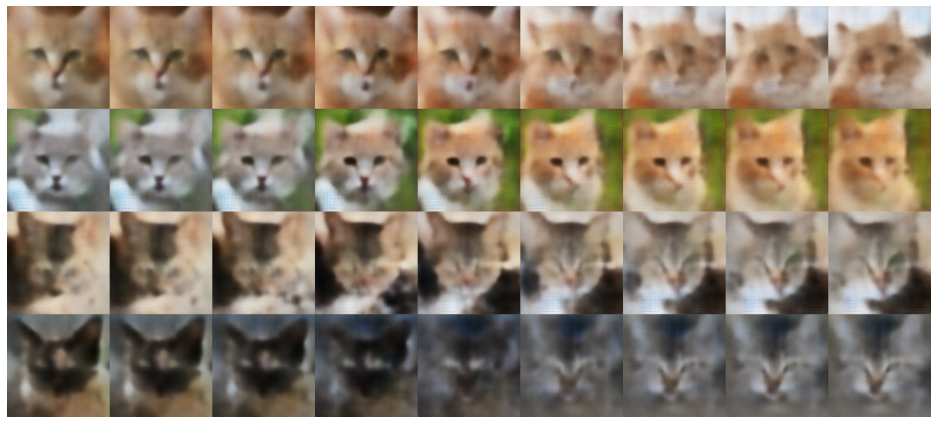

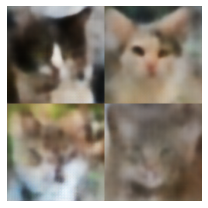


Epoch 121 | Reconstruction loss: 2630.4562855596128 | KLD loss: 546.0089927815502



Epoch 122 | Reconstruction loss: 2622.6749347189198 | KLD loss: 544.726734990659



Epoch 123 | Reconstruction loss: 2597.98940964219 | KLD loss: 546.3667483596328



Epoch 124 | Reconstruction loss: 2608.724183266207 | KLD loss: 545.1128396928681



Epoch 125 | Reconstruction loss: 2592.699267464395 | KLD loss: 545.2249852056088



Epoch 126 | Reconstruction loss: 2584.671698339237 | KLD loss: 543.4812116919097



Epoch 127 | Reconstruction loss: 2586.8498921838604 | KLD loss: 543.2446779049701



Epoch 128 | Reconstruction loss: 2574.0196760663334 | KLD loss: 543.0455637866665



Epoch 129 | Reconstruction loss: 2571.7616217003106 | KLD loss: 544.3835258246949



Epoch 130 | Reconstruction loss: 2570.549257835246 | KLD loss: 543.4078831643051


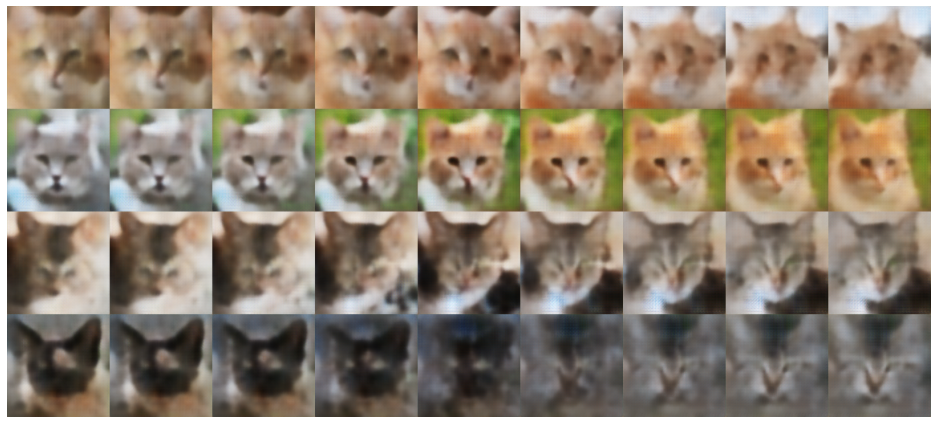

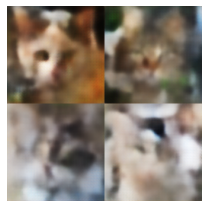


Epoch 131 | Reconstruction loss: 2568.8138914878323 | KLD loss: 544.1464344759165



Epoch 132 | Reconstruction loss: 2553.0338438045906 | KLD loss: 542.3369231135208



Epoch 133 | Reconstruction loss: 2550.089306754355 | KLD loss: 543.3704382854959



Epoch 134 | Reconstruction loss: 2545.207061388478 | KLD loss: 541.2891599761773



Epoch 135 | Reconstruction loss: 2537.0860292422844 | KLD loss: 541.0979116688604



Epoch 136 | Reconstruction loss: 2524.6915533409356 | KLD loss: 542.3212138584682



Epoch 137 | Reconstruction loss: 2522.2842314346976 | KLD loss: 542.0495452406984



Epoch 138 | Reconstruction loss: 2528.046935845606 | KLD loss: 541.0720383543405



Epoch 139 | Reconstruction loss: 2518.4658849491097 | KLD loss: 540.3181256122471



Epoch 140 | Reconstruction loss: 2514.773490763599 | KLD loss: 537.0129379841111


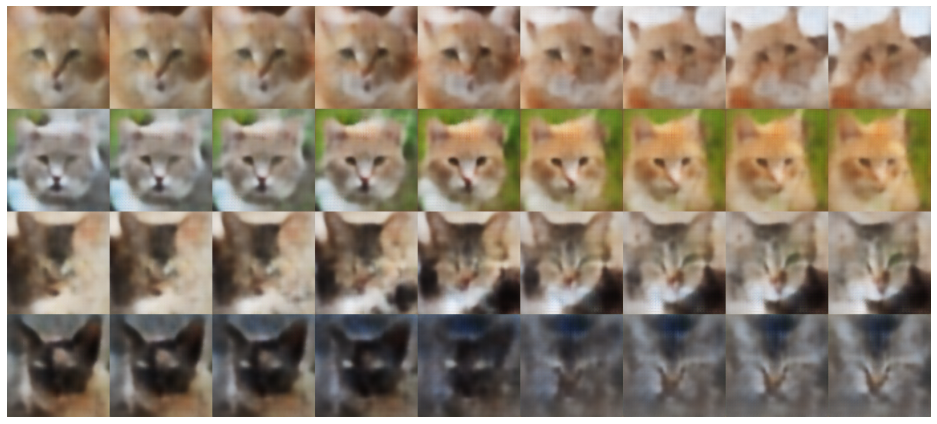

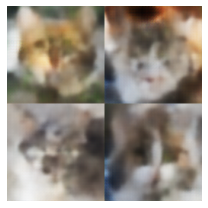


Epoch 141 | Reconstruction loss: 2504.013369352921 | KLD loss: 538.8499022300199



Epoch 142 | Reconstruction loss: 2500.1343347774528 | KLD loss: 538.9534963287922



Epoch 143 | Reconstruction loss: 2489.331486672348 | KLD loss: 536.8882874672457



Epoch 144 | Reconstruction loss: 2492.659845956364 | KLD loss: 537.4441579972735



Epoch 145 | Reconstruction loss: 2492.8307950037606 | KLD loss: 536.2075380597796



Epoch 146 | Reconstruction loss: 2485.797302435644 | KLD loss: 537.1514531011167



Epoch 147 | Reconstruction loss: 2473.482652936663 | KLD loss: 539.2820355433115



Epoch 148 | Reconstruction loss: 2470.0560499866556 | KLD loss: 536.5146421823442



Epoch 149 | Reconstruction loss: 2468.7160726037823 | KLD loss: 537.3673309420947



Epoch 150 | Reconstruction loss: 2467.4398636906785 | KLD loss: 535.3012379237583


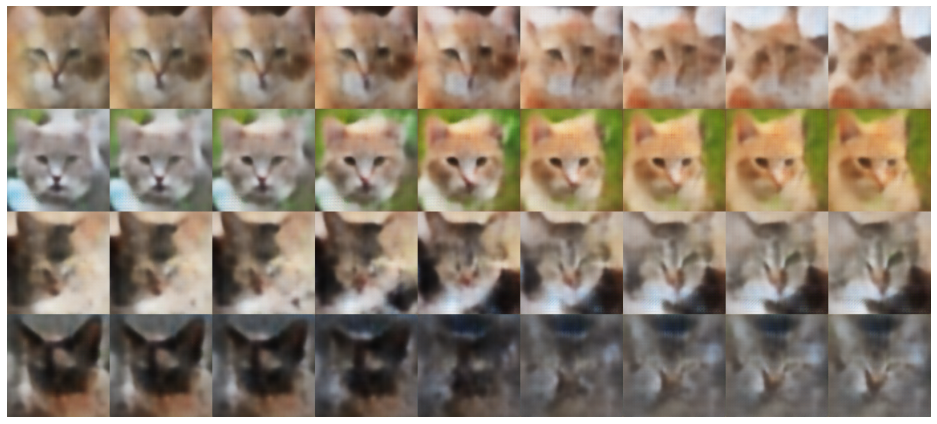

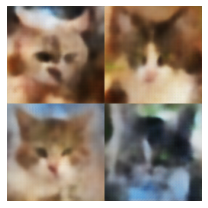


Epoch 151 | Reconstruction loss: 2467.2809707925926 | KLD loss: 536.8723730241289



Epoch 152 | Reconstruction loss: 2445.7326705648293 | KLD loss: 535.7411189108902



Epoch 153 | Reconstruction loss: 2449.974550614446 | KLD loss: 534.2193020174963



Epoch 154 | Reconstruction loss: 2437.7102651655305 | KLD loss: 534.1106645098384



Epoch 155 | Reconstruction loss: 2431.5758805363816 | KLD loss: 532.817852612608



Epoch 156 | Reconstruction loss: 2438.9205244550053 | KLD loss: 531.8877562054936



Epoch 157 | Reconstruction loss: 2430.581883590414 | KLD loss: 535.1770755933678



Epoch 158 | Reconstruction loss: 2435.3284358622864 | KLD loss: 531.9668047887197



Epoch 159 | Reconstruction loss: 2424.183184700723 | KLD loss: 531.8825027276271



Epoch 160 | Reconstruction loss: 2427.3017959120853 | KLD loss: 531.7265883262113


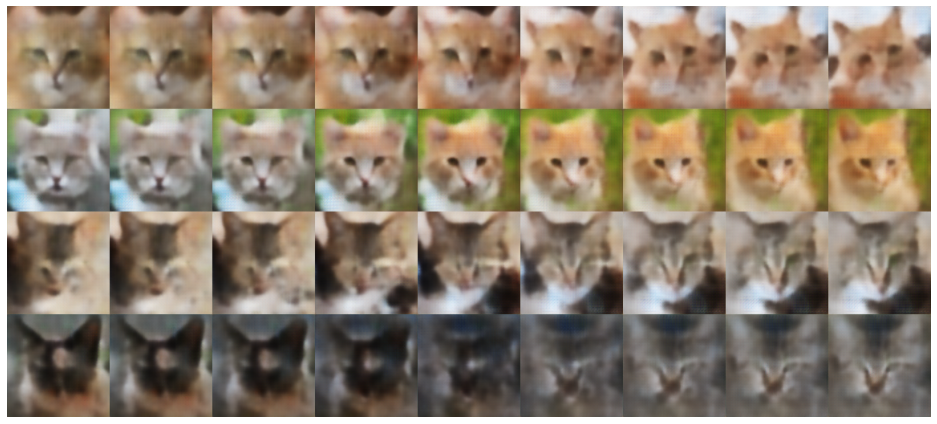

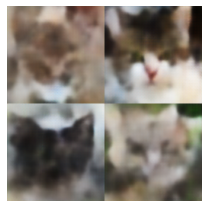


Epoch 161 | Reconstruction loss: 2414.9850725446427 | KLD loss: 532.5208055010494



Epoch 162 | Reconstruction loss: 2414.415850905898 | KLD loss: 531.3066853114536



Epoch 163 | Reconstruction loss: 2418.1793910435267 | KLD loss: 530.7548263739354



Epoch 164 | Reconstruction loss: 2403.939343564999 | KLD loss: 527.9844557009869



Epoch 165 | Reconstruction loss: 2384.284953241763 | KLD loss: 528.2128149470927



Epoch 166 | Reconstruction loss: 2380.371714337272 | KLD loss: 527.9830200005763



Epoch 167 | Reconstruction loss: 2381.812025555913 | KLD loss: 528.6552396027938



Epoch 168 | Reconstruction loss: 2379.7853186945 | KLD loss: 528.8907819001571



Epoch 169 | Reconstruction loss: 2372.1720033254683 | KLD loss: 527.0882095431689



Epoch 170 | Reconstruction loss: 2381.247524853819 | KLD loss: 526.1671725444912


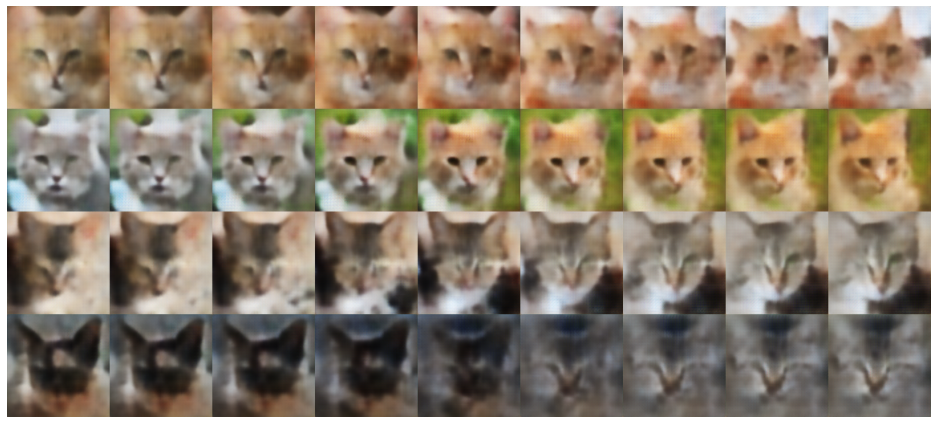

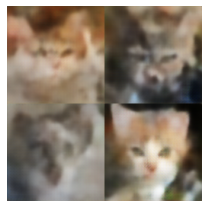


Epoch 171 | Reconstruction loss: 2364.595256923889 | KLD loss: 524.5625376257096



Epoch 172 | Reconstruction loss: 2362.1325920531467 | KLD loss: 526.2101257039893



Epoch 173 | Reconstruction loss: 2376.1298824334 | KLD loss: 524.7373052561505



Epoch 174 | Reconstruction loss: 2358.851800006369 | KLD loss: 526.85776642983



Epoch 175 | Reconstruction loss: 2338.8853477335865 | KLD loss: 521.5731230552152



Epoch 176 | Reconstruction loss: 2355.8002738241826 | KLD loss: 523.6205059075207



Epoch 177 | Reconstruction loss: 2358.932951174908 | KLD loss: 526.3996404327961



Epoch 178 | Reconstruction loss: 2334.5924756541754 | KLD loss: 522.9478453642093



Epoch 179 | Reconstruction loss: 2340.5211138044083 | KLD loss: 522.3896717521715



Epoch 180 | Reconstruction loss: 2342.9028164881356 | KLD loss: 522.4743544774026


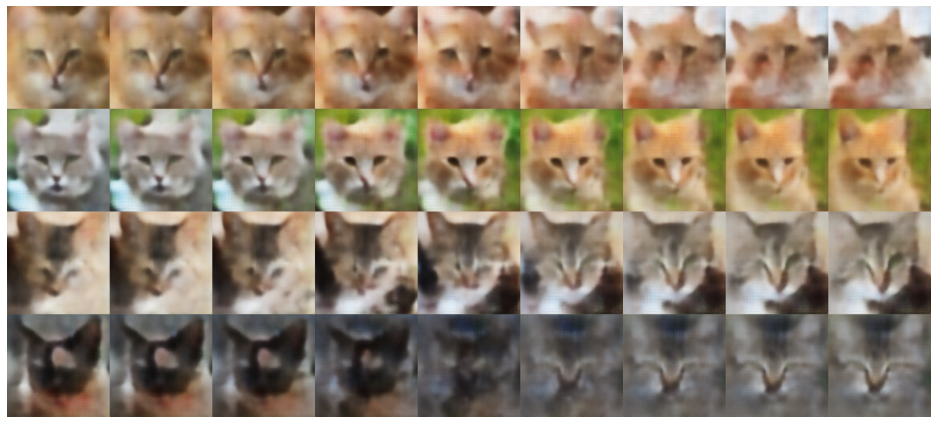

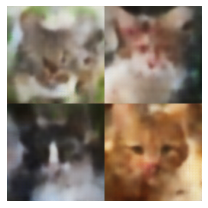


Epoch 181 | Reconstruction loss: 2329.5766432862843 | KLD loss: 522.3160827826268



Epoch 182 | Reconstruction loss: 2334.95929883874 | KLD loss: 520.7488645944536



Epoch 183 | Reconstruction loss: 2320.124921147127 | KLD loss: 519.1993106344472



Epoch 184 | Reconstruction loss: 2313.1121020583632 | KLD loss: 519.0298809738633



Epoch 185 | Reconstruction loss: 2323.6602646727 | KLD loss: 516.8040105689387



Epoch 186 | Reconstruction loss: 2313.7802080426895 | KLD loss: 520.3960056660338



Epoch 187 | Reconstruction loss: 2308.848338061978 | KLD loss: 520.0108104255629



Epoch 188 | Reconstruction loss: 2306.5247099503226 | KLD loss: 517.7632551015535



Epoch 189 | Reconstruction loss: 2300.7175584876018 | KLD loss: 517.4901279425769



Epoch 190 | Reconstruction loss: 2299.7338370566044 | KLD loss: 516.4193290094411


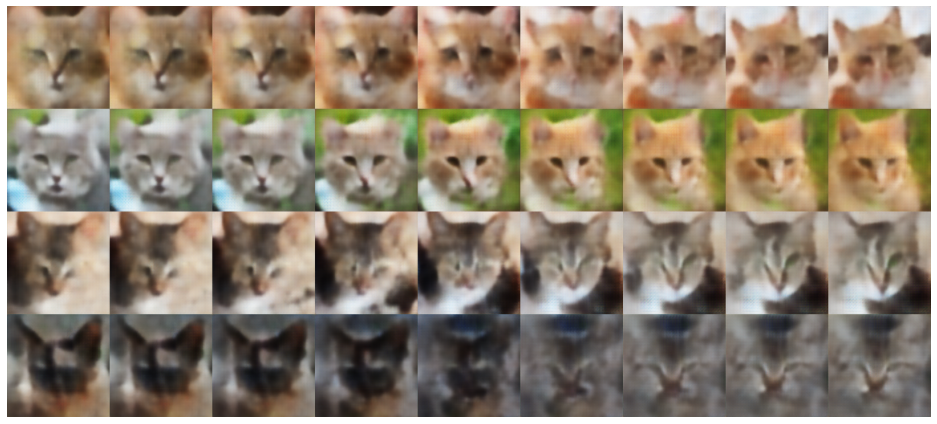

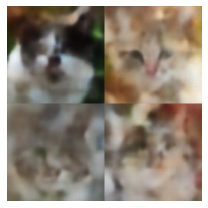


Epoch 191 | Reconstruction loss: 2301.3743168611704 | KLD loss: 516.114349507397



Epoch 192 | Reconstruction loss: 2288.8035445124465 | KLD loss: 516.9041788800163



Epoch 193 | Reconstruction loss: 2288.953316256126 | KLD loss: 515.1851258366745



Epoch 194 | Reconstruction loss: 2289.5124149677918 | KLD loss: 515.7007153907919



Epoch 195 | Reconstruction loss: 2278.6991245435634 | KLD loss: 512.2574930605681



Epoch 196 | Reconstruction loss: 2271.9441388053183 | KLD loss: 512.2784892964808



Epoch 197 | Reconstruction loss: 2280.475044771751 | KLD loss: 511.29124114232036



Epoch 198 | Reconstruction loss: 2280.674252338291 | KLD loss: 513.8322687089814



Epoch 199 | Reconstruction loss: 2258.9711279069415 | KLD loss: 513.1245975849791



Epoch 200 | Reconstruction loss: 2254.7281122622285 | KLD loss: 510.60845923571856


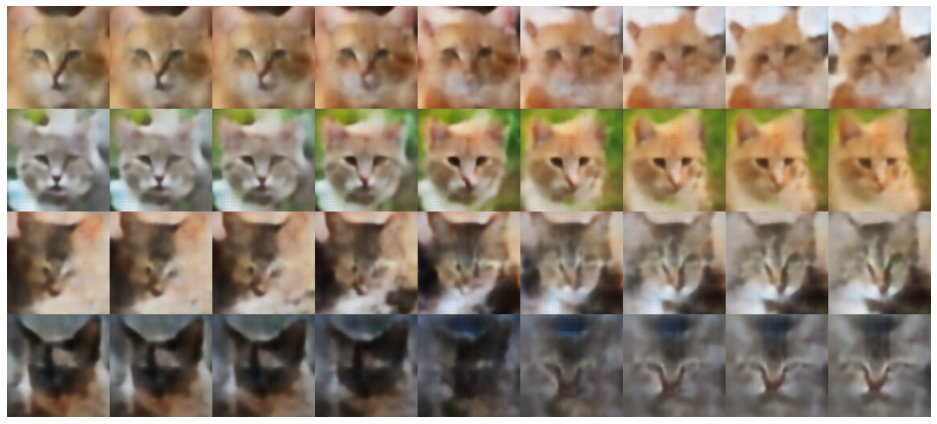

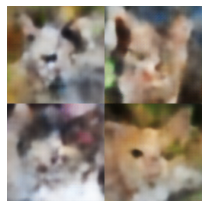


Epoch 201 | Reconstruction loss: 2265.951873779297 | KLD loss: 511.0301243562876


In [19]:
def train_vae():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    vae = VAE()
    vae.to(device)

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.to(device))
                z_2 = vae.encode(test_imgs_2.to(device))
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.to(device)
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()

Котики рисуются и интерполируются, так что все ок!
Мыльные, но это VAE, так что ожидаемо